In [1]:
# Import packages

import psycopg2
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import numpy as np
warnings.filterwarnings("ignore")

In [2]:
# Configure SQL

def execute_statement(sql: str):
    with psycopg2.connect(host="localhost", database="thefantasybot", user="tbakely") as conn:
         df = pd.read_sql(sql, conn)
         return df

weekly_sql = """
select
	wd.player_id,
	wd.player_name,
	position,
	recent_team,
	wd.season,
	wd.week,
	carries,
	rushing_yards,
	rushing_tds,
	rushing_fumbles,
	rushing_fumbles_lost,
	rushing_first_downs,
	rushing_epa,
	efficiency,
	percent_attempts_gte_eight_defenders,
	avg_time_to_los,
	rush_yards_over_expected,
	avg_rush_yards,
	rush_yards_over_expected_per_att,
	rush_pct_over_expected,
	wd.receptions,
	wd.targets,
	receiving_yards,
	receiving_tds,
	receiving_fumbles,
	receiving_fumbles_lost,
	receiving_air_yards,
	receiving_yards_after_catch,
	receiving_first_downs,
	receiving_epa,
	racr,
	target_share,
	air_yards_share,
	wopr,
	offense_snaps,
	offense_pct,
    redzone.redzone,
	(carries + wd.targets) as total_usage,
    wd.fantasy_points,
    wd.fantasy_points_ppr,
	roof,
	surface,
	weather_hazards,
	temp,
	humidity,
	wind_speed
from archive_data.weekly_data wd
left join archive_data.offense_snap_counts os
on wd.player_id = os.id
and wd.season = os.season
and wd.week = os.week
left join archive_data.ngs_rushing_data ngsr
on wd.player_id = ngsr.player_gsis_id
and wd.season = ngsr.season
and wd.week = ngsr.week
left join archive_data.ngs_receiving_data ngsrr
on wd.player_id = ngsrr.player_gsis_id
and wd.season = ngsrr.season
and wd.week = ngsrr.week
left join (select distinct rusher_player_id, game_id, season, week from archive_data.full_pbp) game_id
on wd.player_id = game_id.rusher_player_id
and wd.season = game_id.season
and wd.week = game_id.week
left join archive_data.game_data
on game_data.game_id = game_id.game_id
left join archive_data.redzone_snaps redzone
on wd.player_id = redzone.player_id
and wd.season = redzone.season
and wd.week = redzone.week
where position in ('WR', 'RB', 'TE')
and wd.season between 2016 and 2022;
"""

In [3]:
# Load weekly data from 2016-2022; Modify above query as needed
weekly = execute_statement(weekly_sql)

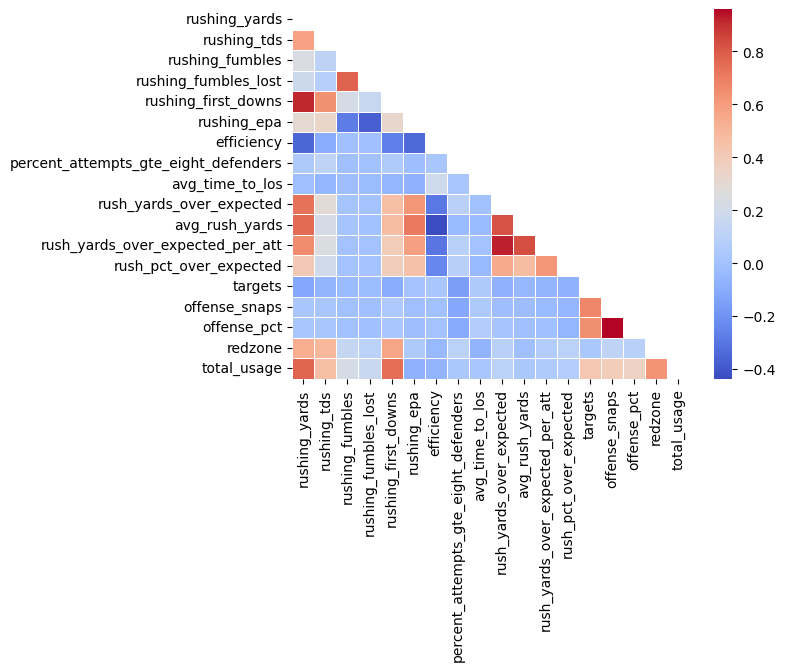

In [5]:
# Define the rushing columns and create a correlation matrix of the rushing data
rushing_cols = [
    "rushing_yards",
    "rushing_tds",
    "rushing_fumbles",
    "rushing_fumbles_lost",
    "rushing_first_downs",
    "rushing_epa",
    "efficiency",
    "percent_attempts_gte_eight_defenders",
    "avg_time_to_los",
    "rush_yards_over_expected",
    "avg_rush_yards",
    "rush_yards_over_expected_per_att",
    "rush_pct_over_expected",
    "targets",
    "offense_snaps",
    "offense_pct",
    "redzone",
    "total_usage",
]

correlation_matrix = weekly[rushing_cols].corr()
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', linewidths=0.5, mask=mask)
plt.show()

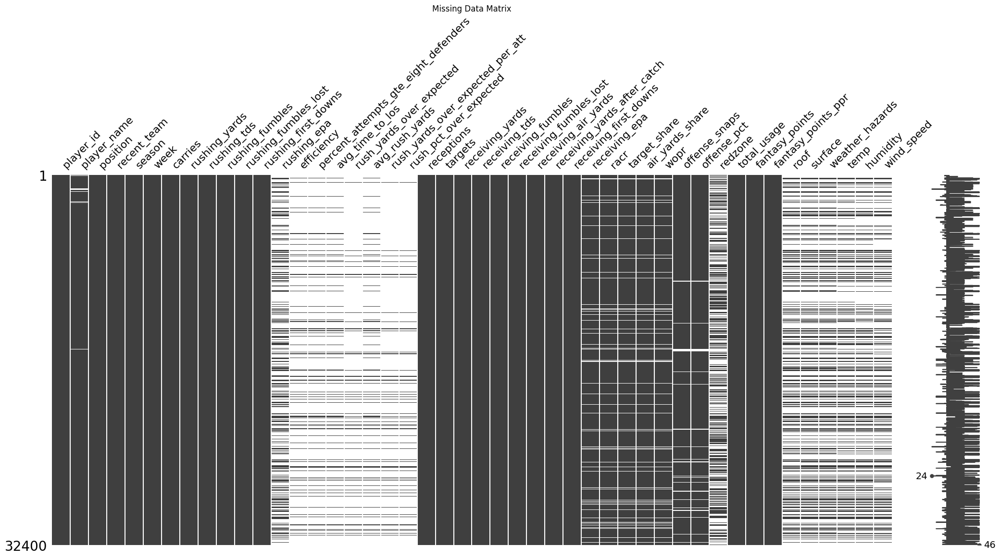

In [44]:
import missingno as msno

# Check for missing data
missing_data = weekly.isnull()

# Visualize missing data
msno.matrix(weekly)
plt.title('Missing Data Matrix')
plt.show()

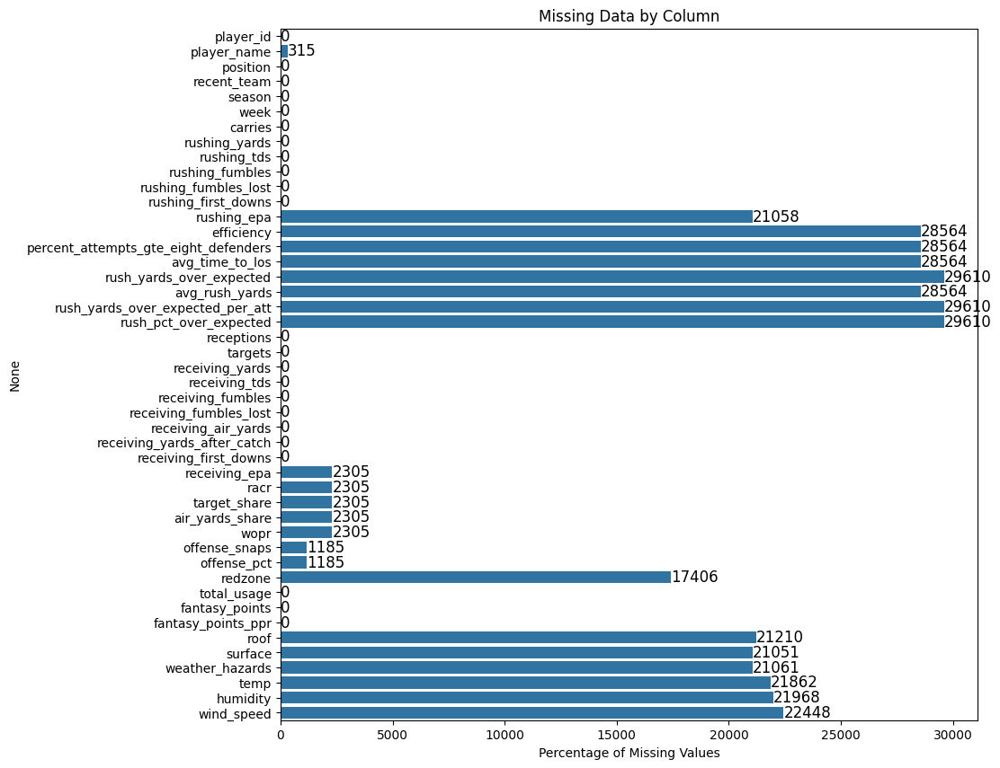

In [45]:
# Calculate the percentage of missing values in each column
missing_percent = weekly.isnull().sum()

# Create a bar plot to visualize missing percentages
plt.figure(figsize=(10, 10))
sns.barplot(x=missing_percent, y=missing_percent.index)

plt.xlabel("Percentage of Missing Values")
plt.title("Missing Data by Column")

# Annotate the bars with the missing values
for i, count in enumerate(missing_percent):
    plt.text(count + 1, i, str(count), va='center', fontsize=12, color='black')

# Show the plot
plt.show()

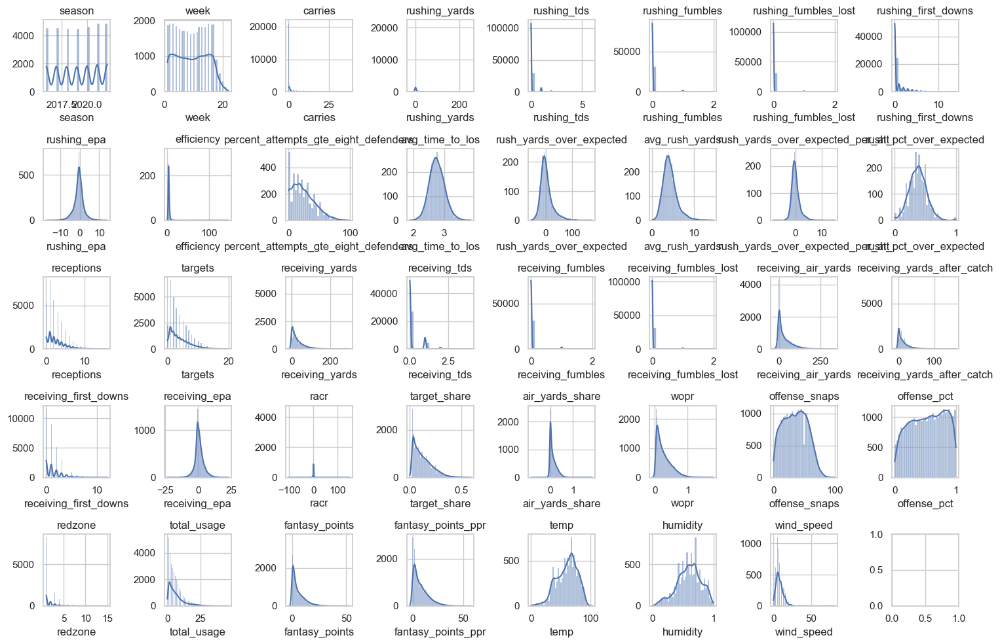

In [6]:
# Set the style of the plots
sns.set(style="whitegrid")

# Filter out numeric columns
numeric_columns = weekly.select_dtypes(include=[np.number])

# Define the number of rows and columns in the subplot grid
nrows = 5  # Number of rows
ncols = 8  # Number of columns

# Create subplots
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, 10))

# Loop through columns and create distribution plots
for i, column in enumerate(numeric_columns.columns):
    row_index = i // ncols
    col_index = i % ncols
    sns.histplot(numeric_columns[column], ax=axes[row_index, col_index], kde=True)
    axes[row_index, col_index].set_title(column)
    axes[row_index, col_index].set_ylabel('')

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()

In [7]:
sns.pairplot(weekly)
plt.show()